# ATDS Project P4 code (except GNN, LLN, and Data Visualization)


Team Members:
Aadithya kandeth - 6980-2791
Anol Kurian V - 56268544

In [2]:
# Project Introduction and Instructions

# Project Title: Predictive Analysis of Global Societal Unrest
# Description:
# This project aims to predict and analyze global societal unrest events (like protests, attacks, 
# and arrests) using advanced machine learning models. The primary data sources include the 
# Global Database of Events, Language, and Tone (GDELT) and the Armed Conflict Location & 
# Event Data Project (ACLED). The project employs models like XGBoost, Graph Neural Networks (GNN), 
# and Large Language Models (LLM) to analyze patterns and forecast potential unrest events.

# Instructions:

# 1. Data Preprocessing:
#    - Load and combine data from GDELT and ACLED.
#    - Clean the data and split it into training, validation, and test sets.

# 2. Model Training:
#    - Train the model on the preprocessed data.

# 3. Data Visualization and Analysis:
#    - Visualize the data before and after model training to understand patterns.
#    - Analyze the results from each model for insights and accuracy.

# 4. Integration and Output:
#    - Combine the results from all models.
#    - Generate comprehensive insights and visualizations for decision-making.

# Note: Ensure all necessary libraries and frameworks (like xgboost, torch, dgl, openai) are installed.


## Data Preprocessing

In [3]:
#memory profiler for computational performance
!pip install memory_profiler
from memory_profiler import profile 

%load_ext memory_profiler

  %reload_ext memory_profiler



[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [4]:
%%memit
#importing time to calculate method runtimes
import time

peak memory: 82.39 MiB, increment: 0.16 MiB


##### Read df1 from GDELT dataset, drop unnecessary columns

##### Then get the top 100 most relevant news articles per day based on importance

In [5]:
start_time = time.time()
import pandas as pd

df1 = pd.read_csv("./Data/GDELT_merged_1998to2023.csv", sep='\t')
column_names = [
    'GLOBALEVENTID', 'SQLDATE', 'MonthYear', 'Year', 'FractionDate',
    'Actor1Code', 'Actor1Name', 'Actor1CountryCode', 'Actor1KnownGroupCode',
    'Actor1EthnicCode', 'Actor1Religion1Code', 'Actor1Religion2Code',
    'Actor1Type1Code', 'Actor1Type2Code', 'Actor1Type3Code', 'Actor2Code',
    'Actor2Name', 'Actor2CountryCode', 'Actor2KnownGroupCode',
    'Actor2EthnicCode', 'Actor2Religion1Code', 'Actor2Religion2Code',
    'Actor2Type1Code', 'Actor2Type2Code', 'Actor2Type3Code', 'IsRootEvent',
    'EventCode', 'EventBaseCode', 'EventRootCode', 'QuadClass',
    'GoldsteinScale', 'NumMentions', 'NumSources', 'NumArticles', 'AvgTone',
    'Actor1Geo_Type', 'Actor1Geo_FullName', 'Actor1Geo_CountryCode',
    'Actor1Geo_ADM1Code', 'Actor1Geo_Lat', 'Actor1Geo_Long',
    'Actor1Geo_FeatureID', 'Actor2Geo_Type', 'Actor2Geo_FullName',
    'Actor2Geo_CountryCode', 'Actor2Geo_ADM1Code', 'Actor2Geo_Lat',
    'Actor2Geo_Long', 'Actor2Geo_FeatureID', 'ActionGeo_Type',
    'ActionGeo_FullName', 'ActionGeo_CountryCode', 'ActionGeo_ADM1Code',
    'ActionGeo_Lat', 'ActionGeo_Long', 'ActionGeo_FeatureID',
    'DATEADDED', 'SOURCEURL'
]

df1.columns = column_names
columns_to_drop = ['SOURCEURL', 'DATEADDED','GLOBALEVENTID','FractionDate','Actor1Name', 'Actor1Religion2Code', 'Actor1Type2Code', 'Actor1Type3Code'
                  ,'Actor2Name', 'Actor2Religion2Code', 'Actor2Type2Code', 'Actor2Type3Code','Actor1Geo_FullName','Actor1Geo_ADM1Code','Actor1Geo_FeatureID',
                  'Actor2Geo_FullName','Actor2Geo_ADM1Code','Actor2Geo_FeatureID','ActionGeo_FullName','ActionGeo_ADM1Code','ActionGeo_FeatureID']
df1 = df1.drop(columns=columns_to_drop)

df1['importance'] = (df1['NumMentions'] + df1['NumSources'] + df1['NumArticles']) / 3


def get_top_100_entries(group):
    return group.nlargest(100, 'importance')
df1['SQLDATE'] = pd.to_datetime(df1['SQLDATE'], format='%Y%m%d', errors='coerce')
top_100_per_day = df1.groupby('SQLDATE', group_keys=False, sort=True).apply(get_top_100_entries)


print(df1.shape)
print(df1.columns)

C:\Users\aadit\AppData\Local\Temp\ipykernel_18860\1225988320.py:4: DtypeWarning: Columns (24,26,27,28) have mixed types. Specify dtype option on import or set low_memory=False.
  df1 = pd.read_csv("./Data/GDELT_merged_1998to2023.csv", sep='\t')


(2857546, 38)
Index(['SQLDATE', 'MonthYear', 'Year', 'Actor1Code', 'Actor1CountryCode',
       'Actor1KnownGroupCode', 'Actor1EthnicCode', 'Actor1Religion1Code',
       'Actor1Type1Code', 'Actor2Code', 'Actor2CountryCode',
       'Actor2KnownGroupCode', 'Actor2EthnicCode', 'Actor2Religion1Code',
       'Actor2Type1Code', 'IsRootEvent', 'EventCode', 'EventBaseCode',
       'EventRootCode', 'QuadClass', 'GoldsteinScale', 'NumMentions',
       'NumSources', 'NumArticles', 'AvgTone', 'Actor1Geo_Type',
       'Actor1Geo_CountryCode', 'Actor1Geo_Lat', 'Actor1Geo_Long',
       'Actor2Geo_Type', 'Actor2Geo_CountryCode', 'Actor2Geo_Lat',
       'Actor2Geo_Long', 'ActionGeo_Type', 'ActionGeo_CountryCode',
       'ActionGeo_Lat', 'ActionGeo_Long', 'importance'],
      dtype='object')


##### For training purposes, considered only 1 month and dropped any further unnecessary columns

In [6]:
# NOTE: temporary filtering due to resource constraints. Can be removed in future iterations.
filtered_df1 = top_100_per_day[top_100_per_day["MonthYear"] == 202201]



filtered_df1['scaled_mood'] =  (filtered_df1["GoldsteinScale"]* filtered_df1["importance"] + filtered_df1["AvgTone"]* filtered_df1["importance"])/2
columns_to_drop = ['MonthYear','Year','GoldsteinScale','NumMentions','NumSources', 'NumArticles','AvgTone','Actor1Geo_Lat','Actor1Geo_Long',
                  'Actor2Geo_Lat','Actor2Geo_Long','ActionGeo_Lat','ActionGeo_Long', 'Actor1Code','Actor1KnownGroupCode', 'Actor1EthnicCode', 'Actor1Religion1Code',
                  'Actor2Code','Actor2KnownGroupCode', 'Actor2EthnicCode', 'Actor2Religion1Code', 'Actor1Geo_Type', 'Actor2Geo_Type']
filtered_df1 = filtered_df1.drop(columns=columns_to_drop)


print(filtered_df1.shape)
print(filtered_df1.head().to_string(index=False))


(3000, 16)
   SQLDATE Actor1CountryCode Actor1Type1Code Actor2CountryCode Actor2Type1Code  IsRootEvent EventCode EventBaseCode EventRootCode  QuadClass Actor1Geo_CountryCode Actor2Geo_CountryCode  ActionGeo_Type ActionGeo_CountryCode  importance  scaled_mood
2022-01-01               NaN             COP               NaN             NaN            1        10            10             1          1                   NaN                   NaN               0                   NaN 2061.666667 -5060.735897
2022-01-01               USA             MNC               NaN             NaN            1       160           160            16          4                    US                   NaN               2                    US 1262.333333 -4852.576083
2022-01-01               NaN             COP               NaN             NaN            1       114           114            11          3                   NaN                   NaN               0                   NaN 1159.666667 -3814.6317

C:\Users\aadit\AppData\Local\Temp\ipykernel_18860\3805826055.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df1['scaled_mood'] =  (filtered_df1["GoldsteinScale"]* filtered_df1["importance"] + filtered_df1["AvgTone"]* filtered_df1["importance"])/2


##### Read ACLED data into df2

In [7]:
%%memit
import os
import sys
import pandas as pd


df2 = pd.read_json("./Data/acled_all_data.json") # read data from json file
print(df2.columns)

Index(['event_id_cnty', 'event_date', 'year', 'time_precision',
       'disorder_type', 'event_type', 'sub_event_type', 'actor1',
       'assoc_actor_1', 'inter1', 'actor2', 'assoc_actor_2', 'inter2',
       'interaction', 'civilian_targeting', 'iso', 'region', 'country',
       'admin1', 'admin2', 'admin3', 'location', 'latitude', 'longitude',
       'geo_precision', 'source', 'source_scale', 'notes', 'fatalities',
       'tags', 'timestamp'],
      dtype='object')
peak memory: 1327.73 MiB, increment: 61.49 MiB


In [8]:
print(df2.shape)

(21604, 31)


In [9]:
print(df2.head().to_string(index=False))

event_id_cnty event_date  year  time_precision          disorder_type             event_type               sub_event_type                                       actor1 assoc_actor_1  inter1                   actor2                 assoc_actor_2  inter2  interaction civilian_targeting  iso         region      country      admin1     admin2     admin3  location  latitude  longitude  geo_precision                                            source         source_scale                                                                                                                                                                                                                                                                                                                                     notes  fatalities tags           timestamp
      BFO6394 2022-01-30  2022               1 Strategic developments Strategic developments Looting/property destruction JNIM: Group for Support of Islam and Muslim

##### Create map of unique countries for each date in the df1

In [10]:
date_country_map = filtered_df1.groupby('SQLDATE')['ActionGeo_CountryCode'].agg(set).to_dict()
print(date_country_map)

{Timestamp('2022-01-01 00:00:00'): {nan, 'AS', 'FR', 'RO', 'UP', 'IT', 'US', 'IN', 'SF', 'PL', 'UK', 'CH', 'RS', 'KN', 'AE', 'BR'}, Timestamp('2022-01-02 00:00:00'): {'AS', nan, 'EI', 'UK', 'US', 'SF', 'KN', 'GZ', 'KS', 'IS', 'SU'}, Timestamp('2022-01-03 00:00:00'): {nan, 'AS', 'SN', 'SZ', 'BR', 'IZ', 'UK', 'US', 'IR', 'RS', 'KN', 'GM', 'KS', 'IS', 'SU'}, Timestamp('2022-01-04 00:00:00'): {nan, 'FR', 'CB', 'IZ', 'IC', 'UK', 'US', 'SF', 'CH', 'JA'}, Timestamp('2022-01-05 00:00:00'): {'HK', 'AS', nan, 'FR', 'VE', 'LT', 'UK', 'US', 'SF', 'KN', 'CH', 'KZ', 'IS'}, Timestamp('2022-01-06 00:00:00'): {nan, 'UK', 'US', 'BF', 'RE', 'RS', 'GM', 'CH', 'PK', 'KZ', 'IS'}, Timestamp('2022-01-07 00:00:00'): {nan, 'FR', 'CB', 'MX', 'UK', 'US', 'RS', 'GM', 'KZ'}, Timestamp('2022-01-08 00:00:00'): {nan, 'FR', 'AS', 'CB', 'UP', 'UK', 'US', 'AL', 'CH', 'ER', 'RS', 'ET', 'KZ', 'TH'}, Timestamp('2022-01-09 00:00:00'): {nan, 'VT', 'UP', 'UK', 'US', 'SP', 'RS', 'OD', 'PE', 'CY', 'KZ', 'BR', 'SU'}, Timestamp('2

##### Mapping between FIPS 10-4 and ISO 3166 country codes

In [11]:
country_map={'4':'AF','8':'AL','12':'AG','16':'AQ','20':'AN','24':'AO','660':'AV','28':'AC','32':'AR','51':'AM','533':'AA','36':'AS','40':'AU','31':'AJ','44':'BF','48':'BA','50':'BG','52':'BB','112':'BO','56':'BE','84':'BZ','204':'BN','60':'BM','64':'BT','68':'BL','70':'BK','72':'BC','76':'BR','92':'VI','96':'BX','100':'BU','854':'UV','116':'CB','120':'CM','124':'CA','132':'CV','136':'CJ','140':'CT','148':'CD','152':'BL','156':'CH','162':'KT','166':'CK','170':'CO','174':'CN','178':'CF','184':'CW','188':'CS','384':'CI','191':'HR','192':'CU','196':'CY','203':'EZ','208':'DA','262':'DJ','212':'DO','214':'DR','218':'EC','818':'EG','222':'ES','226':'EK','232':'ER','233':'EN','231':'ET','238':'FA','234':'FO','242':'FJ','246':'FI','250':'FR','254':'FG','258':'FP','266':'GB','270':'GA','268':'GE','276':'GM','288':'GH','292':'GI','300':'GR','304':'GL','308':'GJ','312':'GP','316':'GQ','320':'GT','316':'GU','324':'GN','624':'PU','328':'GY','332':'HA','336':'VT','340':'HO','348':'HU','352':'IC','356':'IN','360':'ID','364':'IR','368':'IZ','372':'EI','376':'IS','380':'IT','388':'JM','392':'JA','400':'JO','398':'KZ','404':'KE','408':'KR','410':'KS','414':'KU','417':'KG','418':'LA','428':'LG','422':'LE','430':'LT','438':'LU','440':'LV','442':'LT','807':'MK','450':'MA','454':'MI','458':'MY','462':'MV','466':'ML','470':'MT','474':'MB','478':'MR','480':'MP','175':'YT','484':'MX','583':'FM','498':'MD','492':'MC','500':'MS','504':'MO','508':'MZ','104':'BM','516':'WA','520':'NR','524':'NP','528':'NL','530':'NT','540':'NC','554':'NZ','558':'NU','566':'NG','562':'NE','566':'NI','570':'NU','574':'NF','580':'CQ','578':'NO','512':'MU','586':'PK','585':'PS','591':'PM','598':'PP','600':'PA','604':'PE','608':'RP','612':'PC','616':'PL','620':'PO','630':'RQ','634':'QA','638':'RE','642':'RO','643':'RS','646':'RW','659':'SC','662':'ST','666':'SB','670':'VC','674':'SM','678':'TP','682':'SA','686':'SG','688':'SR','703':'SV','705':'SI','090':'BP','706':'SO','710':'SF','724':'SP','144':'CE','729':'SU','740':'NS','744':'SV','748':'WZ','752':'SW','756':'SZ','760':'SY','158':'TW','762':'TI','834':'TZ','764':'TH','768':'TO','772':'TL','776':'TN','780':'TD','788':'TS','792':'TU','795':'TX','796':'TK','798':'TV','800':'UG','804':'UP','784':'TC','826':'UK','840':'US','858':'UY','860':'UZ','548':'NH','862':'VE','704':'VM','850':'VQ','876':'WF','732':'WI','882':'WS','887':'YM','710':'ZA','894':'ZR','716':'ZI','434':'LY','275':'WE','180':'CG','499':'MJ','728':'OD','0':'XK','108':'BI','663':'MF','496':'MN','831':'GG','694':'SL','296':'KI','626':'TT','531':'CW','426':'LT'}
reverse_country_map = {
    'AF': '4',
    'AL': '8',
    'AG': '12',
    'AQ': '16',
    'AN': '20',
    'AO': '24',
    'AV': '660',
    'AC': '28',
    'AR': '32',
    'AM': '51',
    'AA': '533',
    'AS': '36',
    'AU': '40',
    'AJ': '31',
    'BF': '44',
    'BA': '48',
    'BG': '50',
    'BB': '52',
    'BO': '112',
    'BE': '56',
    'BZ': '84',
    'BN': '204',
    'BM': '60',
    'BT': '64',
    'BL': '68',
    'BK': '70',
    'BC': '72',
    'BR': '76',
    'VI': '92',
    'BX': '96',
    'BU': '100',
    'UV': '854',
    'CB': '116',
    'CM': '120',
    'CA': '124',
    'CV': '132',
    'CJ': '136',
    'CT': '140',
    'CD': '148',
    'BL': '152',
    'CH': '156',
    'KT': '162',
    'CK': '166',
    'CO': '170',
    'CN': '174',
    'CF': '178',
    'CW': '184',
    'CS': '188',
    'CI': '384',
    'HR': '191',
    'CU': '192',
    'CY': '196',
    'EZ': '203',
    'DA': '208',
    'DJ': '262',
    'DO': '212',
    'DR': '214',
    'EC': '218',
    'EG': '818',
    'ES': '222',
    'EK': '226',
    'ER': '232',
    'EN': '233',
    'ET': '231',
    'FA': '238',
    'FO': '234',
    'FJ': '242',
    'FI': '246',
    'FR': '250',
    'FG': '254',
    'FP': '258',
    'GB': '266',
    'GA': '270',
    'GE': '268',
    'GM': '276',
    'GH': '288',
    'GI': '292',
    'GR': '300',
    'GL': '304',
    'GJ': '308',
    'GP': '312',
    'GQ': '316',
    'GT': '320',
    'GU': '316',
    'GN': '324',
    'PU': '624',
    'GY': '328',
    'HA': '332',
    'VT': '336',
    'HO': '340',
    'HU': '348',
    'IC': '352',
    'IN': '356',
    'ID': '360',
    'IR': '364',
    'IZ': '368',
    'EI': '372',
    'IS': '376',
    'IT': '380',
    'JM': '388',
    'JA': '392',
    'JO': '400',
    'KZ': '398',
    'KE': '404',
    'KR': '408',
    'KS': '410',
    'KU': '414',
    'KG': '417',
    'LA': '418',
    'LG': '428',
    'LE': '422',
    'LT': '430',
    'LU': '438',
    'LV': '440',
    'LT': '442',
    'MK': '807',
    'MA': '450',
    'MI': '454',
    'MY': '458',
    'MV': '462',
    'ML': '466',
    'MT': '470',
    'MB': '474',
    'MR': '478',
    'MP': '480',
    'YT': '175',
    'MX': '484',
    'FM': '583',
    'MD': '498',
    'MC': '492',
    'MS': '500',
    'MO': '504',
    'MZ': '508',
    'BM': '104',
    'WA': '516',
    'NR': '520',
    'NP': '524',
    'NL': '528',
    'NT': '530',
    'NC': '540',
    'NZ': '554',
    'NU': '558',
    'NG': '566',
    'NE': '562',
    'NI': '566',
    'NU': '570',
    'NF': '574',
    'CQ': '580',
    'NO': '578',
    'MU': '512',
    'PK': '586',
    'PS': '585',
    'PM': '591',
    'PP': '598',
    'PA': '600',
    'PE': '604',
    'RP': '608',
    'PC': '612',
    'PL': '616',
    'PO': '620',
    'RQ': '630',
    'QA': '634',
    'RE': '638',
    'RO': '642',
    'RS': '643',
    'RW': '646',
    'SC': '659',
    'ST': '662',
    'SB': '666',
    'VC': '670',
    'SM': '674',
    'TP': '678',
    'SA': '682',
    'SG': '686',
    'SR': '688',
    'SV': '703',
    'SI': '705',
    'BP': '090',
    'SO': '706',
    'SF': '710',
    'SP': '724',
    'CE': '144',
    'SU': '729',
    'NS': '740',
    'SV': '744',
    'WZ': '748',
    'SW': '752',
    'SZ': '756',
    'SY': '760',
    'TW': '158',
    'TI': '762',
    'TZ': '834',
    'TH': '764',
    'TO': '768',
    'TL': '772',
    'TN': '776',
    'TD': '780',
    'TS': '788',
    'TU': '792',
    'TX': '795',
    'TK': '796',
    'TV': '798',
    'UG': '800',
    'UP': '804',
    'TC': '784',
    'UK': '826',
    'US': '840',
    'UY': '858',
    'UZ': '860',
    'NH': '548',
    'VE': '862',
    'VM': '704',
    'VQ': '850',
    'WF': '876',
    'WI': '732',
    'WS': '882',
    'YM': '887',
    'ZA': '710',
    'ZR': '894',
    'ZI': '716',
    'LY': '434',
    'WE': '275',
    'CG': '180',
    'MJ': '499',
    'OD': '728',
    'XK': '0',
    'BI': '108',
    'MF': '663',
    'MN': '496',
    'GG': '831',
    'SL': '694',
    'KI': '296',
    'TT': '626',
    'CW': '531',
    'LT': '426'
}

##### Mappings for output classes (0...25). Each integer stands for a different social unrest event type

In [12]:
event_index = {
    "Government regains territory": "0",
    "Non-state actor overtakes territory": "1",
    "Armed clash": "2",
    "Excessive force against protesters": "3",
    "Protest with intervention": "4",
    "Peaceful protest": '5',
    "Violent demonstration": "6",
    "Mob violence": "7",
    "Chemical weapon": "8",
    "Air/drone strike": "9",
    "Suicide bomb": "10",
    "Shelling/artillery/missile attack": "11",
    "Remote explosive/landmine/IED": "12",
    "Grenade": "13",
    "Sexual violence": "14",
    "Attack": "15",
    "Abduction/forced disappearance": "16",
    "Agreement": "17",
    "Arrests": "18",
    "Change to group/activity": "19",
    "Disrupted weapons use": "20",
    "Headquarters or base established": "21",
    "Looting/property destruction": "22",
    "Non-violent transfer of territory": "23",
    "Other": "24"
}


In [13]:
reverse_event_index ={
    "0": "Government regains territory",
    "1": "Non-state actor overtakes territory",
    "2": "Armed clash",
    "3": "Excessive force against protesters",
    "4": "Protest with intervention",
    "5": "Peaceful protest",
    "6": "Violent demonstration",
    "7": "Mob violence",
    "8": "Chemical weapon",
    "9": "Air/drone strike",
    "10": "Suicide bomb",
    "11": "Shelling/artillery/missile attack",
    "12": "Remote explosive/landmine/IED",
    "13": "Grenade",
    "14": "Sexual violence",
    "15": "Attack",
    "16": "Abduction/forced disappearance",
    "17": "Agreement",
    "18": "Arrests",
    "19": "Change to group/activity",
    "20": "Disrupted weapons use",
    "21": "Headquarters or base established",
    "22": "Looting/property destruction",
    "23": "Non-violent transfer of territory",
    "24": "Other"
}


In [14]:
y_event_map = {
    "y0": "Government regains territory",
    "y1": "Non-state actor overtakes territory",
    "y2": "Armed clash",
    "y3": "Excessive force against protesters",
    "y4": "Protest with intervention",
    "y5": "Peaceful protest",
    "y6": "Violent demonstration",
    "y7": "Mob violence",
    "y8": "Chemical weapon",
    "y9": "Air/drone strike",
    "y10": "Suicide bomb",
    "y11": "Shelling/artillery/missile attack",
    "y12": "Remote explosive/landmine/IED",
    "y13": "Grenade",
    "y14": "Sexual violence",
    "y15": "Attack",
    "y16": "Abduction/forced disappearance",
    "y17": "Agreement",
    "y18": "Arrests",
    "y19": "Change to group/activity",
    "y20": "Disrupted weapons use",
    "y21": "Headquarters or base established",
    "y22": "Looting/property destruction",
    "y23": "Non-violent transfer of territory",
    "y24": "Other"
}

##### Generate columns y0 to y25 for multitarget classification

In [15]:
xydf1 = filtered_df1

for i in range(25):
    column_name = f'y{i}'  # Generate column name (y0, y1, ..., y24)
    xydf1[column_name] = 0

In [16]:
df2['event_date'] = pd.to_datetime(df2['event_date'])

#### Mapping the GDELT data to the ACLED output labels. xydf1 has the merged dataset

In [17]:
%%memit
xydf1_temp = xydf1

for index, row in df2.iterrows():
    date = row['event_date']
    country = row['iso']
    print(row['country'])
    country_fips = country_map[str(country)] 
    sub_event_type = row['sub_event_type']
    column = 'y'+ str(event_index[sub_event_type])
    
    # Check if the associated country is in the hashmap value for the date key
    if country_fips in date_country_map.get(date, []):
        # If it's there, print the row
        
        filter1 = xydf1['SQLDATE'] == date
        filter2 = xydf1['ActionGeo_CountryCode'] == country_fips
        filter3 = xydf1['scaled_mood'] < 0

        xydf1_temp.loc[filter1 & filter2 & filter3, column] = 1
        
        #print(row)

Burkina Faso
Burkina Faso
Burkina Faso
Burkina Faso
Ghana
Mali
Mali
Nigeria
Nigeria
Nigeria
Tunisia
Ivory Coast
Niger
Nigeria
Central African Republic
Nigeria
Nigeria
Morocco
Algeria
Algeria
Libya
Nigeria
Nigeria
Burkina Faso
Burkina Faso
Iran
Israel
Palestine
Turkey
Turkey
Turkey
Israel
Iran
Lebanon
Palestine
Turkey
Costa Rica
Haiti
Mexico
Mexico
Mexico
Mexico
Mexico
Mexico
Cuba
Cuba
Dominican Republic
Mexico
Puerto Rico
Puerto Rico
El Salvador
El Salvador
El Salvador
Mexico
Mexico
Mexico
Mexico
Mexico
Mexico
Mexico
Mexico
El Salvador
Mexico
Mexico
Mexico
Mexico
Mexico
Mexico
Trinidad and Tobago
Mexico
Mexico
Sudan
Tanzania
Democratic Republic of Congo
Democratic Republic of Congo
Democratic Republic of Congo
Democratic Republic of Congo
eSwatini
Iraq
Syria
Syria
Syria
Syria
Syria
Syria
Iraq
Iraq
Iraq
Syria
Syria
Syria
Iraq
Syria
Syria
Argentina
Colombia
Brazil
Brazil
Brazil
Brazil
Brazil
Venezuela
Venezuela
Brazil
Brazil
Brazil
Brazil
Brazil
Brazil
Brazil
Brazil
Argentina
Peru
Bolivi

In [18]:
print(xydf1_temp.shape)
xdf1 = xydf1_temp.iloc[:, :-25]
ydf1 = xydf1_temp.iloc[:, -25:]
print(xdf1.shape)
print(ydf1.shape)


xdf1_beforeonehot = xdf1

(3000, 41)
(3000, 16)
(3000, 25)


## ENCODING

In [19]:
!pip install joblib


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


#### Encoding all categorical variables

In [20]:
%%memit
import pandas as pd
from sklearn.preprocessing import LabelBinarizer
import joblib

# Columns for each group
group_A_cols = ['Actor1CountryCode', 'Actor2CountryCode']
group_B_cols = ['Actor1Type1Code', 'Actor2Type1Code']
group_C_cols = ['EventCode']
group_D_cols = ['QuadClass']
group_E_cols = ['Actor1Geo_CountryCode', 'Actor2Geo_CountryCode', 'ActionGeo_CountryCode']

xdf1[group_A_cols] = xdf1[group_A_cols].fillna('UNKNOWN')
xdf1[group_B_cols] = xdf1[group_B_cols].fillna('UNKNOWN1')
xdf1[group_C_cols] = xdf1[group_C_cols].fillna('UNKNOWN2')
xdf1[group_D_cols] = xdf1[group_D_cols].fillna('UNKNOWN3')
xdf1[group_E_cols] = xdf1[group_E_cols].fillna('UNKNOWN4')

xdf1[group_C_cols] = xdf1[group_C_cols].astype(str) #Convert eventCodes to sting

xdf1 = pd.get_dummies(xdf1, columns=['Actor1Geo_CountryCode', 'Actor2Geo_CountryCode', 'ActionGeo_CountryCode'], prefix=['A1GCC_', 'A2GCC_', 'AGCC_'])
xdf1 = pd.get_dummies(xdf1, columns=['Actor1CountryCode', 'Actor2CountryCode'], prefix=['A1CC_', 'A2CC_'])
xdf1 = pd.get_dummies(xdf1, columns=['Actor1Type1Code', 'Actor2Type1Code'], prefix=['A1TC_', 'A2TC_'])
xdf1 = pd.get_dummies(xdf1, columns=['EventCode'], prefix=['EC_'])
xdf1 = pd.get_dummies(xdf1, columns=['QuadClass'], prefix=['QC_'])


peak memory: 1310.61 MiB, increment: 29.20 MiB


In [21]:
print(xdf1.head())

         SQLDATE  IsRootEvent EventBaseCode EventRootCode  ActionGeo_Type  \
317   2022-01-01            1            10             1               0   
834   2022-01-01            1           160            16               2   
1484  2022-01-01            1           114            11               0   
35839 2022-01-01            1            14             1               2   
15831 2022-01-01            1            43             4               2   

        importance  scaled_mood  A1GCC__AE  A1GCC__AF  A1GCC__AG  ...  EC__84  \
317    2061.666667 -5060.735897      False      False      False  ...   False   
834    1262.333333 -4852.576083      False      False      False  ...   False   
1484   1159.666667 -3814.631776      False      False      False  ...   False   
35839  1117.000000 -3307.349424      False      False      False  ...   False   
15831  1115.333333  1743.673384      False      False      False  ...   False   

       EC__841  EC__86  EC__873  EC__874  EC__90  

In [22]:
print(ydf1.head())

       y0  y1  y2  y3  y4  y5  y6  y7  y8  y9  ...  y15  y16  y17  y18  y19  \
317     0   0   0   0   0   0   0   0   0   0  ...    0    0    0    0    0   
834     0   0   0   0   0   1   0   0   0   0  ...    0    0    0    0    0   
1484    0   0   0   0   0   0   0   0   0   0  ...    0    0    0    0    0   
35839   0   0   0   0   0   1   0   0   0   0  ...    0    0    0    0    0   
15831   0   0   0   0   0   0   0   0   0   0  ...    0    0    0    0    0   

       y20  y21  y22  y23  y24  
317      0    0    0    0    0  
834      0    0    0    0    0  
1484     0    0    0    0    0  
35839    0    0    0    0    0  
15831    0    0    0    0    0  

[5 rows x 25 columns]


In [23]:
print(xydf1_temp.head())

         SQLDATE Actor1CountryCode Actor1Type1Code Actor2CountryCode  \
317   2022-01-01               NaN             COP               NaN   
834   2022-01-01               USA             MNC               NaN   
1484  2022-01-01               NaN             COP               NaN   
35839 2022-01-01               NaN             NaN               NaN   
15831 2022-01-01               NaN             NaN               USA   

      Actor2Type1Code  IsRootEvent EventCode EventBaseCode EventRootCode  \
317               NaN            1        10            10             1   
834               NaN            1       160           160            16   
1484              NaN            1       114           114            11   
35839             BUS            1        14            14             1   
15831             NaN            1        43            43             4   

       QuadClass  ... y15 y16  y17 y18  y19  y20  y21  y22  y23  y24  
317            1  ...   0   0    0   0 

In [24]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [25]:
end_time = time.time()
runtime = end_time - start_time
print(f"\n \n *** Preprocesing executed in {runtime:.4f} seconds *** \n \n")


 
 *** Preprocesing executed in 33.5894 seconds *** 
 



#### Save current processed dataframes into CSVs for future use

In [26]:
from datetime import datetime

current_datetime = datetime.now().strftime("%d%m_%H%M")

# Create the filename with the current date and time
filename = f"./Data/{current_datetime}_xdf1.csv"
xdf1.to_csv(filename, index=False)
filename = f"./Data/{current_datetime}_ydf1.csv"
ydf1.to_csv(filename, index=False)
filename = f"./Data/{current_datetime}_xydf1_temp.csv"
xydf1_temp.to_csv(filename, index=False)

## MODELS

In [27]:
!pip install tensorflow


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [28]:
print(xdf1.shape)

(3000, 608)


#### Encoding date field as number of days to add temporal ordinality

In [29]:
%%memit
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report
from tensorflow import keras
from tensorflow.keras import layers
print('shape', xdf1.shape)
xdf1['SQLDATE'] = pd.to_datetime(xydf1_temp['SQLDATE'])
print(xdf1.shape)
reference_date = pd.to_datetime('1970-01-01')
print(xdf1.shape)
xdf1['no_of_days'] = (xdf1['SQLDATE'] - reference_date).dt.days
print(xdf1.shape)
xdf1.drop(['SQLDATE'], axis=1, inplace=True)
print(xdf1.shape)

# Extracting features (X) and targets (Y)

#Store data into numpy arrays
X = xdf1.values
Y = ydf1.values

print(len(X),len(X[0]))
print(len(Y),len(Y[0]))




shape (3000, 608)
(3000, 608)
(3000, 608)
(3000, 609)
(3000, 608)
3000 608
3000 25
peak memory: 1440.43 MiB, increment: 128.48 MiB


In [30]:
print(xdf1.shape)

(3000, 608)


In [31]:
print(xdf1.columns)
print(ydf1.columns)
print(xydf1_temp.columns)

Index(['IsRootEvent', 'EventBaseCode', 'EventRootCode', 'ActionGeo_Type',
       'importance', 'scaled_mood', 'A1GCC__AE', 'A1GCC__AF', 'A1GCC__AG',
       'A1GCC__AL',
       ...
       'EC__841', 'EC__86', 'EC__873', 'EC__874', 'EC__90', 'QC__1', 'QC__2',
       'QC__3', 'QC__4', 'no_of_days'],
      dtype='object', length=608)
Index(['y0', 'y1', 'y2', 'y3', 'y4', 'y5', 'y6', 'y7', 'y8', 'y9', 'y10',
       'y11', 'y12', 'y13', 'y14', 'y15', 'y16', 'y17', 'y18', 'y19', 'y20',
       'y21', 'y22', 'y23', 'y24'],
      dtype='object')
Index(['SQLDATE', 'Actor1CountryCode', 'Actor1Type1Code', 'Actor2CountryCode',
       'Actor2Type1Code', 'IsRootEvent', 'EventCode', 'EventBaseCode',
       'EventRootCode', 'QuadClass', 'Actor1Geo_CountryCode',
       'Actor2Geo_CountryCode', 'ActionGeo_Type', 'ActionGeo_CountryCode',
       'importance', 'scaled_mood', 'y0', 'y1', 'y2', 'y3', 'y4', 'y5', 'y6',
       'y7', 'y8', 'y9', 'y10', 'y11', 'y12', 'y13', 'y14', 'y15', 'y16',
       'y17', 'y18',

#### Train test split

In [32]:
# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
print(X_train.shape)
print(xdf1.dtypes)


(2400, 608)
IsRootEvent          int64
EventBaseCode       object
EventRootCode       object
ActionGeo_Type       int64
importance         float64
scaled_mood        float64
A1GCC__AE             bool
A1GCC__AF             bool
A1GCC__AG             bool
A1GCC__AL             bool
A1GCC__AM             bool
A1GCC__AS             bool
A1GCC__BE             bool
A1GCC__BF             bool
A1GCC__BM             bool
A1GCC__BO             bool
A1GCC__BR             bool
A1GCC__BU             bool
A1GCC__BX             bool
A1GCC__CA             bool
A1GCC__CB             bool
A1GCC__CF             bool
A1GCC__CH             bool
A1GCC__CM             bool
A1GCC__CO             bool
A1GCC__CU             bool
A1GCC__CY             bool
A1GCC__DA             bool
A1GCC__EC             bool
A1GCC__EG             bool
A1GCC__EI             bool
A1GCC__EN             bool
A1GCC__ET             bool
A1GCC__FI             bool
A1GCC__FR             bool
A1GCC__GA             bool
A1GCC__GM       

In [33]:
print(xdf1.shape)

(3000, 608)


# NEURAL NETWORK MODELS

## Model 1 (Working :- NN 608:128:64:25 RELU Sigmoid)

In [34]:
!pip install matplotlib
!pip install seaborn
start_time = time.time()


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [35]:
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score
import seaborn as sns

def NNModel(X_train, X_test, Y_train, Y_test):
    # Standardize the features
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)

    # Build the neural network model
    input_dim = X_train.shape[1]
    output_dim = Y_train.shape[1]

    model = keras.Sequential([
        layers.Dense(128, input_dim=input_dim, activation='relu'),
        layers.Dense(64, activation='relu'),
        layers.Dense(output_dim, activation='sigmoid')  # Assuming binary classification for each event
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Train the model
    history = model.fit(X_train, Y_train, epochs=20, batch_size=32, validation_data=(X_test, Y_test))

    # Evaluate the model on the test set
    loss, accuracy = model.evaluate(X_test, Y_test)
    print(f'Test Loss: {loss}, Test Accuracy: {accuracy}')

    plt.figure(figsize=(12, 6))

    # Plot training & validation accuracy values
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Validation'], loc='upper left')

    plt.tight_layout()
    plt.show()

    # Make predictions on new data
    predictions = model.predict(X_test)

    # Convert predictions and true labels to binary classes (assuming binary classification)
    predictions_binary = (predictions > 0.5).astype(int)
    Y_test_binary = Y_test.astype(int)

    # Calculate additional metrics
    precision = precision_score(Y_test_binary, predictions_binary, average='weighted')
    recall = recall_score(Y_test_binary, predictions_binary, average='weighted')
    f1 = f1_score(Y_test_binary, predictions_binary, average='weighted')
    accuracy = accuracy_score(Y_test_binary, predictions_binary)

    print(f'Precision: {precision:.2f}')
    print(f'Recall: {recall:.2f}')
    print(f'F1-Score: {f1:.2f}')
    print(f'Accuracy: {accuracy:.2f}')

    # Generate a classification report for detailed metrics
    class_report = classification_report(Y_test_binary, predictions_binary, output_dict=True)
    print("Classification Report:\n", class_report)

    print(class_report)

    report_df = pd.DataFrame(class_report).transpose()
    # Drop the 'support' column if not needed for the plot
    report_df.drop(columns=['support'], inplace=True, errors='ignore')
    report_df = report_df.iloc[:-4, :]

    # Plotting
    plt.figure(figsize=(20, 10))
    sns.heatmap(report_df.astype(float), cmap="Blues", fmt='.2f')
    plt.title("Classification Report")
    plt.show()
    
    model.save('C:/gdelt/models/nn_model.h5')
    return predictions



Epoch 1/20


75/75 [==============================] - 1s 4ms/step - loss: 0.2575 - accuracy: 0.2262 - val_loss: 0.1089 - val_accuracy: 0.2850
Epoch 2/20
75/75 [==============================] - 0s 2ms/step - loss: 0.0988 - accuracy: 0.2862 - val_loss: 0.0889 - val_accuracy: 0.2883
Epoch 3/20
75/75 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.2967 - val_loss: 0.0821 - val_accuracy: 0.2867
Epoch 4/20
75/75 [==============================] - 0s 2ms/step - loss: 0.0671 - accuracy: 0.3067 - val_loss: 0.0799 - val_accuracy: 0.2950
Epoch 5/20
75/75 [==============================] - 0s 2ms/step - loss: 0.0595 - accuracy: 0.3129 - val_loss: 0.0790 - val_accuracy: 0.3050
Epoch 6/20
75/75 [==============================] - 0s 2ms/step - loss: 0.0543 - accuracy: 0.3142 - val_loss: 0.0783 - val_accuracy: 0.3083
Epoch 7/20
75/75 [==============================] - 0s 2ms/step - loss: 0.0498 - accuracy: 0.3146 - val_loss: 0.0788 - val_accuracy: 0.2983
Epoch 8/20
75/75

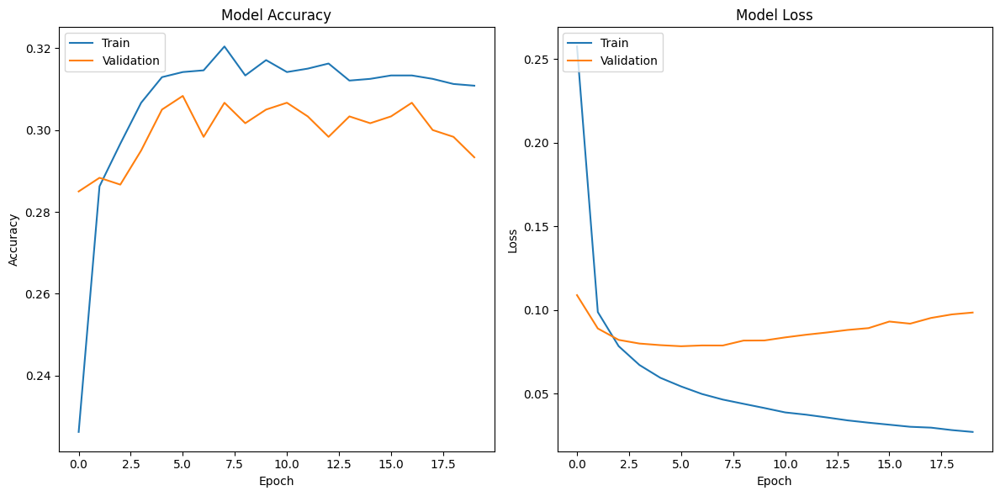

19/19 [==============================] - 0s 894us/step
Precision: 0.69
Recall: 0.61
F1-Score: 0.64
Accuracy: 0.65
Classification Report:
 {'0': {'precision': 1.0, 'recall': 0.3333333333333333, 'f1-score': 0.5, 'support': 3.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 0.0}, '2': {'precision': 0.875, 'recall': 0.875, 'f1-score': 0.875, 'support': 32.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 1.0}, '4': {'precision': 0.6582278481012658, 'recall': 0.5842696629213483, 'f1-score': 0.619047619047619, 'support': 89.0}, '5': {'precision': 0.8992805755395683, 'recall': 0.9057971014492754, 'f1-score': 0.9025270758122743, 'support': 276.0}, '6': {'precision': 0.5333333333333333, 'recall': 0.2962962962962963, 'f1-score': 0.38095238095238093, 'support': 27.0}, '7': {'precision': 0.14285714285714285, 'recall': 0.029411764705882353, 'f1-score': 0.04878048780487805, 'support': 34.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support':

c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1760: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len

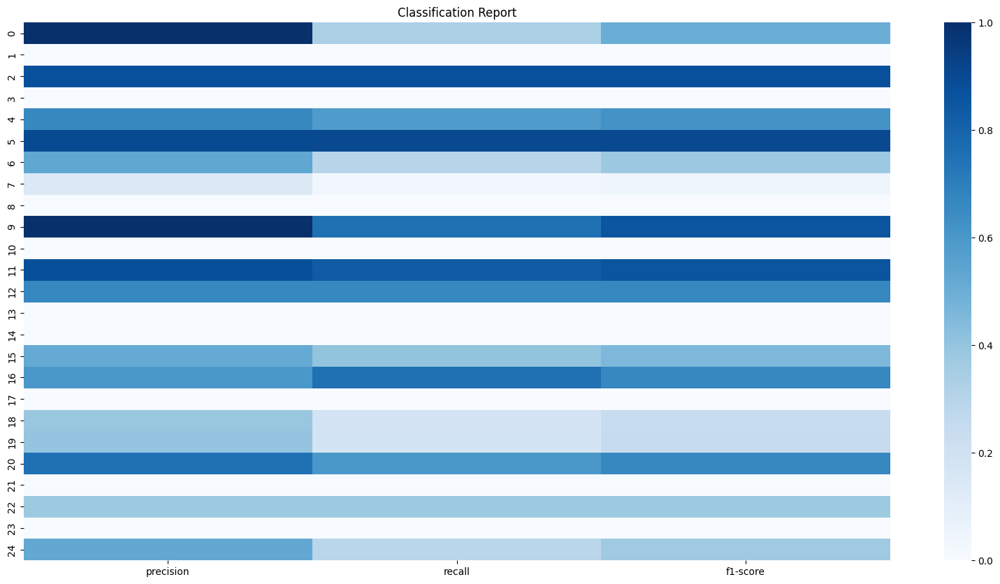

peak memory: 1555.19 MiB, increment: 92.03 MiB


c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [36]:
%%memit
p = NNModel(X_train, X_test, Y_train, Y_test)

In [37]:
print(p[0])


[3.0004531e-07 3.8477264e-08 3.1802626e-06 4.2248398e-06 1.3862750e-03
 3.1975895e-02 3.0361053e-07 2.7406903e-05 8.4882083e-07 1.9175211e-06
 2.5109020e-06 4.8871370e-06 9.1704862e-07 1.1395038e-06 1.4707331e-08
 7.6541204e-05 3.0196456e-05 2.1151507e-06 5.0760584e-04 2.7146494e-05
 1.1551642e-05 5.7042886e-08 9.1213888e-06 1.2726116e-06 1.1157246e-03]


In [38]:
end_time = time.time()
runtime = end_time - start_time
print(f"\n \n *** NN Model executed in {runtime:.4f} seconds *** \n \n")


 
 *** NN Model executed in 7.0383 seconds *** 
 



## Test Models (Experimenting with different architectures)
## Convert from raw code to code cell to run (Optional)
## Model 2

## Model 3

## Model 4

## Random Forests Model

In [39]:
start_time = time.time()


In [40]:
print(xdf1.shape)

(3000, 608)


In [41]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, hamming_loss

@profile
def RandomForestModel(xdf1,ydf1):
    X = xdf1  # Input features
    Y = ydf1[['y0', 'y1', 'y2', 'y3', 'y4', 'y5', 'y6', 'y7', 'y8', 'y9', 'y10',
             'y11', 'y12', 'y13', 'y14', 'y15', 'y16', 'y17', 'y18', 'y19', 'y20',
             'y21', 'y22', 'y23', 'y24']]  # Output variables

    # Split the data into training and testing sets
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

    # Initialize the Random Forest model
    rf = RandomForestClassifier(n_estimators=100, random_state=42)

    # Fit the model on the training data
    rf.fit(X_train, Y_train)

    # Predict on the test data
    Y_pred = rf.predict(X_test)

    # Evaluate the model performance
    accuracy = accuracy_score(Y_test, Y_pred)
    hamming_loss_value = hamming_loss(Y_test, Y_pred)

    print(f'Accuracy: {accuracy}')
    print(f'Hamming Loss: {hamming_loss_value}')
    f1_scores = f1_score(Y_test, Y_pred, average=None)
    recall_scores = recall_score(Y_test, Y_pred, average=None)
    precision_scores = precision_score(Y_test, Y_pred, average=None)
    
    
    # Generate a classification report for detailed metrics
    class_report = classification_report(Y_test, Y_pred)
    print("Classification Report:\n", class_report)

    #print metrics
    for i in range(len(f1_scores)):
        print(f'Class {i} - F1 Score: {f1_scores[i]}, Recall: {recall_scores[i]}, Precision: {precision_scores[i]}')
    return Y_pred


In [42]:
%%memit
# Assuming Y_pred is a NumPy array or similar structure
# And assuming we have the column names for the Y variables
Y_pred = RandomForestModel(xdf1,ydf1)

ERROR: Could not find file C:\Users\aadit\AppData\Local\Temp\ipykernel_18860\2946846528.py
Accuracy: 0.705
Hamming Loss: 0.02033333333333333
Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.33      0.50         3
           1       0.00      0.00      0.00         0
           2       0.96      0.84      0.90        32
           3       0.00      0.00      0.00         1
           4       0.88      0.51      0.64        89
           5       0.92      0.97      0.95       276
           6       1.00      0.19      0.31        27
           7       0.50      0.09      0.15        34
           8       0.00      0.00      0.00         0
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00        18
          12       0.86      0.67      0.75         9
          13       0.00      0.00      0.00         2
          14       0.00 

c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1760: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, l

##### Print Predictions

In [43]:
y_columns = ['y0', 'y1', 'y2', 'y3', 'y4', 'y5', 'y6', 'y7', 'y8', 'y9', 'y10',
             'y11', 'y12', 'y13', 'y14', 'y15', 'y16', 'y17', 'y18', 'y19', 'y20',
             'y21', 'y22', 'y23', 'y24']

# Transpose the predictions to iterate over columns (labels) instead of rows (samples)
Y_pred_transposed = Y_pred.T

# Print each label's predictions
for label, predictions in zip(y_columns, Y_pred_transposed):
    print(f"{label} ({y_event_map[label]}): {predictions.tolist()}")

y0 (Government regains territory): [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

In [44]:
end_time = time.time()
runtime = end_time - start_time
print(f"\n \n *** XYZ executed in {runtime:.4f} seconds *** \n \n")


 
 *** XYZ executed in 3.7183 seconds *** 
 



## KNN Model

In [45]:
start_time = time.time()

In [46]:
print(xydf1_temp.head())

         SQLDATE Actor1CountryCode Actor1Type1Code Actor2CountryCode  \
317   2022-01-01               NaN             COP               NaN   
834   2022-01-01               USA             MNC               NaN   
1484  2022-01-01               NaN             COP               NaN   
35839 2022-01-01               NaN             NaN               NaN   
15831 2022-01-01               NaN             NaN               USA   

      Actor2Type1Code  IsRootEvent EventCode EventBaseCode EventRootCode  \
317               NaN            1        10            10             1   
834               NaN            1       160           160            16   
1484              NaN            1       114           114            11   
35839             BUS            1        14            14             1   
15831             NaN            1        43            43             4   

       QuadClass Actor1Geo_CountryCode Actor2Geo_CountryCode  ActionGeo_Type  \
317            1              

In [47]:
X = xdf1  # All columns except the last 25
Y = ydf1 # Only the last 25 columns

#### Finding optimal K using the elbow method (Optional), can be ignored for now. k has been selected after manual testing

In [48]:
import numpy as np
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, hamming_loss, f1_score, jaccard_score, precision_score, recall_score, roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score

@profile
def KnnModel(X,Y):
    # train test split
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

    knn = KNeighborsClassifier(n_neighbors=6)

    k_fold = 5  # You can change the number of folds as needed
    scores = cross_val_score(knn, X, Y, cv=k_fold, scoring='accuracy')  # You can choose a different scoring metric if needed
    # Print the cross-validation scores
    print(f"Cross-Validation Scores: {scores}")
    print(f"Mean Accuracy: {np.mean(scores)}")
    print(f"Standard Deviation: {np.std(scores)}")

    ks = range(1, 20)
    accuracies = []


    knn.fit(X_train, y_train)

    y_pred = knn.predict(X_test)

    # Evaluate the model using various metrics

    # Hamming Loss
    hamming_loss_value = hamming_loss(y_test, y_pred)
    print(f"Hamming Loss: {hamming_loss_value}")

    # Accuracy Score
    accuracy_score_value = accuracy_score(y_test, y_pred)
    print(f"Accuracy Score: {accuracy_score_value}")

    # F1 Score
    f1_score_micro = f1_score(y_test, y_pred, average='micro')
    f1_score_macro = f1_score(y_test, y_pred, average='macro')
    f1_score_weighted = f1_score(y_test, y_pred, average='weighted')
    print(f"F1 Score (Micro): {f1_score_micro}")
    print(f"F1 Score (Macro): {f1_score_macro}")
    print(f"F1 Score (Weighted): {f1_score_weighted}")

    # Jaccard Score
    jaccard_score_value = jaccard_score(y_test, y_pred, average='samples')
    print(f"Jaccard Score: {jaccard_score_value}")

    # Precision and Recall
    precision = precision_score(y_test, y_pred, average='micro')
    recall = recall_score(y_test, y_pred, average='micro')
    print(f"Precision: {precision}")
    print(f"Recall: {recall}")
    # Generate a classification report for detailed metrics
    class_report = classification_report(y_test, y_pred)
    print("Classification Report:\n", class_report)
    return y_pred

In [49]:
%%memit
y_pred = KnnModel(X,Y)
end_time = time.time()
runtime = end_time - start_time
print(f"\n \n *** XYZ executed in {runtime:.4f} seconds *** \n \n")

ERROR: Could not find file C:\Users\aadit\AppData\Local\Temp\ipykernel_18860\1067483079.py
Cross-Validation Scores: [0.54666667 0.54666667 0.52       0.46166667 0.515     ]
Mean Accuracy: 0.518
Standard Deviation: 0.031080540535840095
Hamming Loss: 0.037066666666666664
Accuracy Score: 0.5483333333333333
F1 Score (Micro): 0.4516765285996055
F1 Score (Macro): 0.0401510796290593
F1 Score (Weighted): 0.3316077267307694
Jaccard Score: 0.22955026455026456
Precision: 0.7003058103975535
Recall: 0.3333333333333333
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00         3
           1       0.00      0.00      0.00         0
           2       0.50      0.03      0.06        32
           3       0.00      0.00      0.00         1
           4       0.30      0.08      0.12        89
           5       0.74      0.79      0.76       276
           6       0.00      0.00      0.00        27
           7       0.00      0.0

c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1760: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1760: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in samples with no true or predicted labels. Use `zero_division` parameter to control this behavior.
  _wa

In [50]:
for i in range(25):
    print(f"{y_event_map['y'+str(i)]}: {y_pred[i]}")


Government regains territory: [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Non-state actor overtakes territory: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Armed clash: [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Excessive force against protesters: [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Protest with intervention: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Peaceful protest: [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Violent demonstration: [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Mob violence: [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Chemical weapon: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Air/drone strike: [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Suicide bomb: [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Shelling/artillery/missile attack: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Remote explosive/landmine/IED: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Grenade: [0

## HMM Model (Ignore, complete code is below)

## HMM For Predicting Hidden States

In [51]:
!pip install hmmlearn


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [52]:
start_time = time.time()

In [53]:
hmdf = pd.read_csv("./Data/sorted_df.csv", sep = ',')
print(hmdf.head())

      SQLDATE Actor1CountryCode Actor1Type1Code Actor2CountryCode  \
0  2022-01-01               NaN             NaN               WST   
1  2022-01-01               NaN             COP               NaN   
2  2022-01-01               NaN             CVL               NaN   
3  2022-01-01               NaN             GOV               NaN   
4  2022-01-01               USA             NaN               NaN   

  Actor2Type1Code  IsRootEvent  EventCode  EventBaseCode  EventRootCode  \
0             IGO            0         40             40              4   
1             NaN            1         90             90              9   
2             NaN            1        160            160             16   
3             NaN            0         20             20              2   
4             COP            1         10             10              1   

   QuadClass Actor1Geo_CountryCode Actor2Geo_CountryCode  ActionGeo_Type  \
0          1                   NaN                    IT  

not sure whether below env var is required (probably not):

In [54]:
import pandas as pd
from hmmlearn import hmm
import numpy as np
from sklearn.preprocessing import LabelEncoder

@profile
def HmmModel(hmdf):
    # Initialize label encoders for categorical columns
    categorical_columns = ['Actor1CountryCode', 'Actor1Type1Code', 'Actor2CountryCode', 
                           'Actor2Type1Code', 'Actor1Geo_CountryCode', 'Actor2Geo_CountryCode', 
                           'ActionGeo_CountryCode', 'y']

    encoders = {col: LabelEncoder() for col in categorical_columns}

    # Fit label encoders and transform columns to encode categorical variables
    for col, encoder in encoders.items():
        hmdf[col] = encoder.fit_transform(hmdf[col])

    # Convert 'SQLDATE' to ordinal
    hmdf['SQLDATE'] = pd.to_datetime(hmdf['SQLDATE']).map(pd.Timestamp.toordinal)

    # Preparing the dataset for the HMM
    # The observations (X) will be all columns except 'y'
    # The states (y) to predict will be the column 'y'
    X = hmdf.drop(columns=['y']).values
    lengths = [len(X)]  # Since we only have one sample, the length is the total number of observations
    y = hmdf['y'].values.reshape(-1, 1)

    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Number of states for 'y'
    n_states = len(np.unique(y))

    # Train a Gaussian HMM
    # Note: In a real-world scenario, you would have to tune the following parameters
    model = hmm.GaussianHMM(
        n_components=n_states,
        covariance_type="diag",  # Change to 'diag' to enforce diagonal covariance matrices
        n_iter=100,
        min_covar=1e-3  # This is a form of regularization
    )
    # Fit the HMM model
    model.fit(X_scaled, lengths)

    # After fitting the model, we can predict the hidden states for new data
    # For demonstration, we'll predict states for our single sample
    hidden_states = model.predict(X_scaled)

    print("Predicted hidden states for the sample:")
    print(hidden_states)
    return hidden_states,model,X_scaled,lengths


In [55]:
%%memit
hidden_states,HmmModel,X_scaled,lengths = HmmModel(hmdf)
print(min(hidden_states))
print(max(hidden_states))

ERROR: Could not find file C:\Users\aadit\AppData\Local\Temp\ipykernel_18860\3774507387.py


Model is not converging.  Current: 9923.601042972427 is not greater than 9923.979618380668. Delta is -0.3785754082418862


Predicted hidden states for the sample:
[15 14 12 ... 20 14 18]
0
21
peak memory: 1549.34 MiB, increment: 22.90 MiB


In [56]:
# Log-Likelihood
log_likelihood = HmmModel.score(X_scaled, lengths)
print("Log-Likelihood:", log_likelihood)

# Perplexity
# Perplexity can be calculated as exp(-log-likelihood / n_samples)
perplexity = np.exp(-log_likelihood / len(hidden_states))
print("Perplexity:", perplexity)

Log-Likelihood: 9923.272282874384
Perplexity: 0.06581278721217555


In [57]:
end_time = time.time()
runtime = end_time - start_time
print(f"\n \n *** HMM Hidden States executed in {runtime:.4f} seconds *** \n \n")


 
 *** HMM Hidden States executed in 8.8873 seconds *** 
 



### NetworkX Graph Visualization

In [58]:
start_time = time.time()

In [59]:
gdf1 = filtered_df1
gdf2 = df2

In [60]:
print(gdf1.columns)
print(gdf2.columns)

Index(['SQLDATE', 'Actor1CountryCode', 'Actor1Type1Code', 'Actor2CountryCode',
       'Actor2Type1Code', 'IsRootEvent', 'EventCode', 'EventBaseCode',
       'EventRootCode', 'QuadClass', 'Actor1Geo_CountryCode',
       'Actor2Geo_CountryCode', 'ActionGeo_Type', 'ActionGeo_CountryCode',
       'importance', 'scaled_mood', 'y0', 'y1', 'y2', 'y3', 'y4', 'y5', 'y6',
       'y7', 'y8', 'y9', 'y10', 'y11', 'y12', 'y13', 'y14', 'y15', 'y16',
       'y17', 'y18', 'y19', 'y20', 'y21', 'y22', 'y23', 'y24'],
      dtype='object')
Index(['event_id_cnty', 'event_date', 'year', 'time_precision',
       'disorder_type', 'event_type', 'sub_event_type', 'actor1',
       'assoc_actor_1', 'inter1', 'actor2', 'assoc_actor_2', 'inter2',
       'interaction', 'civilian_targeting', 'iso', 'region', 'country',
       'admin1', 'admin2', 'admin3', 'location', 'latitude', 'longitude',
       'geo_precision', 'source', 'source_scale', 'notes', 'fatalities',
       'tags', 'timestamp'],
      dtype='object')


In [61]:
!pip install networkx


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [62]:
gdf1 = filtered_df1
gdf2 = df2
# gdf1 = gdf1.iloc[:,:-25]

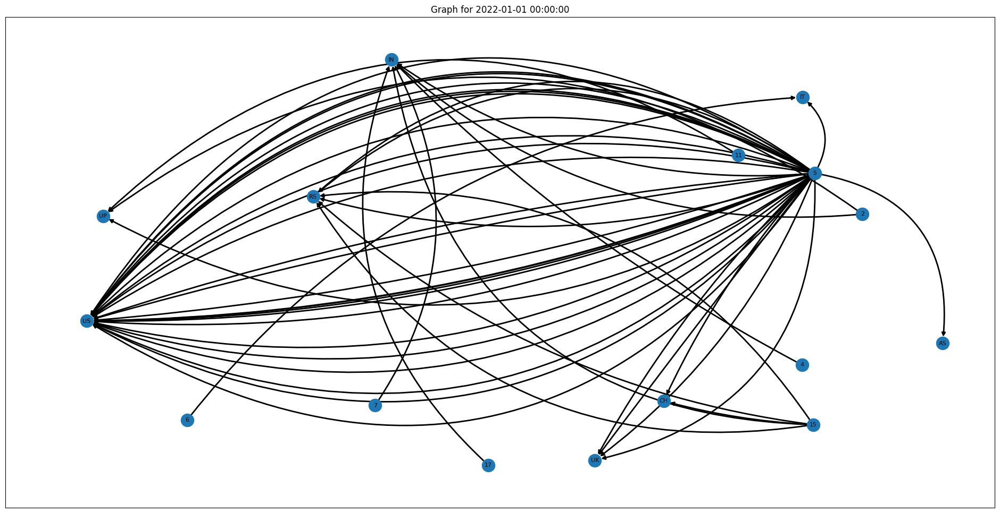

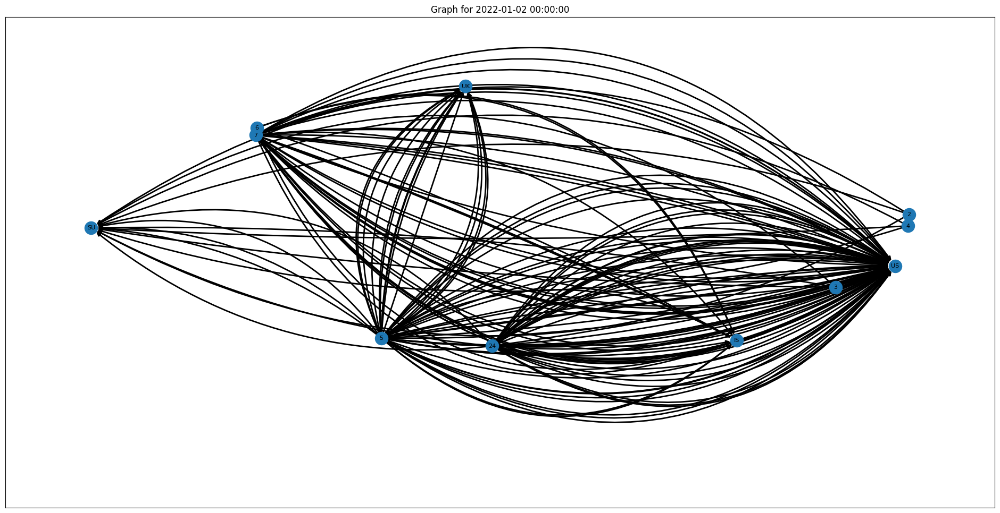

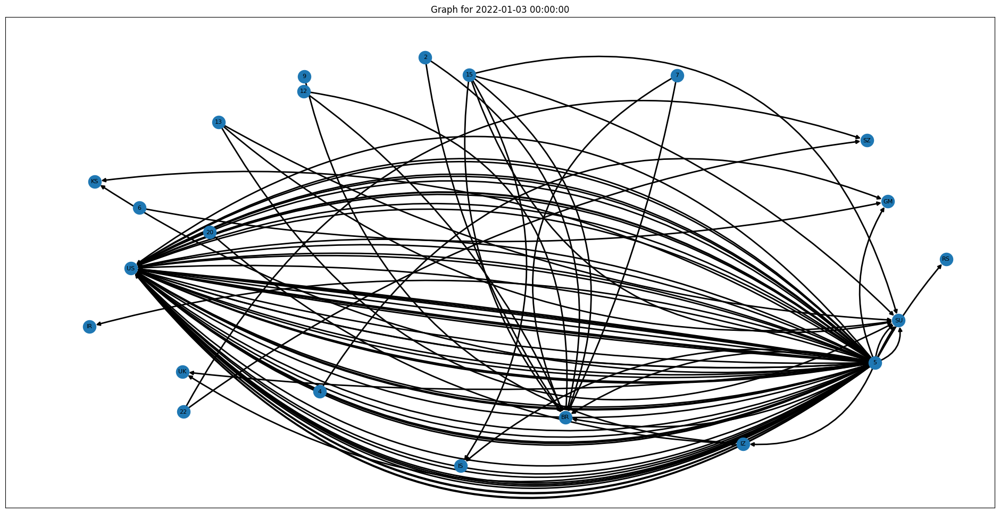

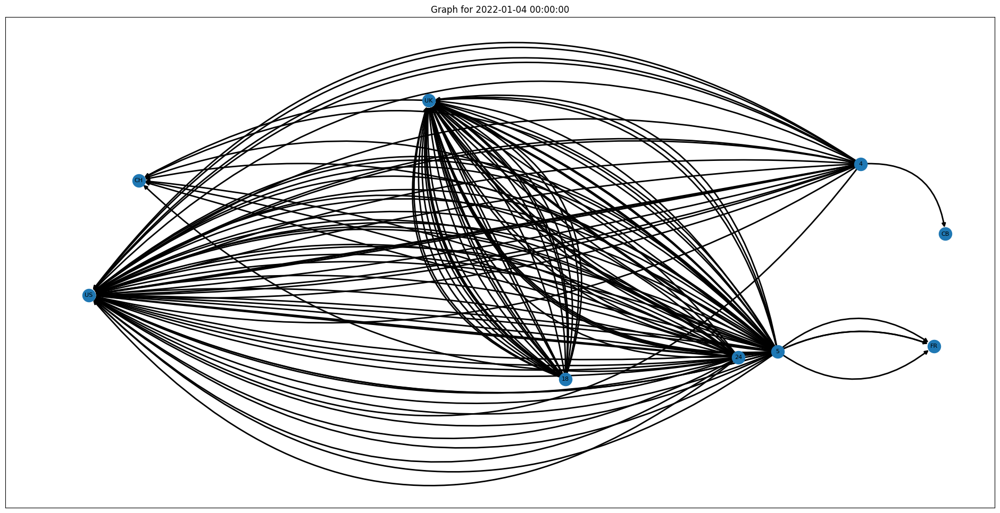

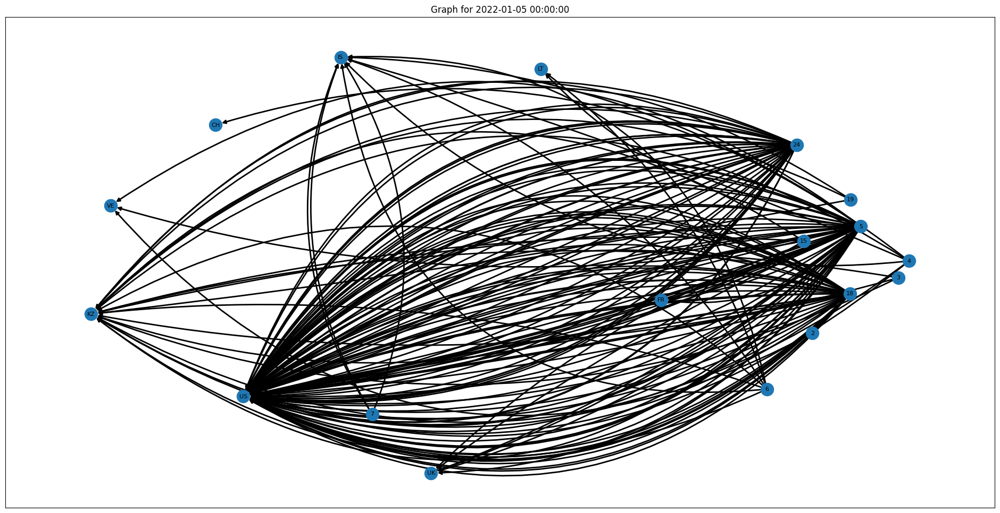

...

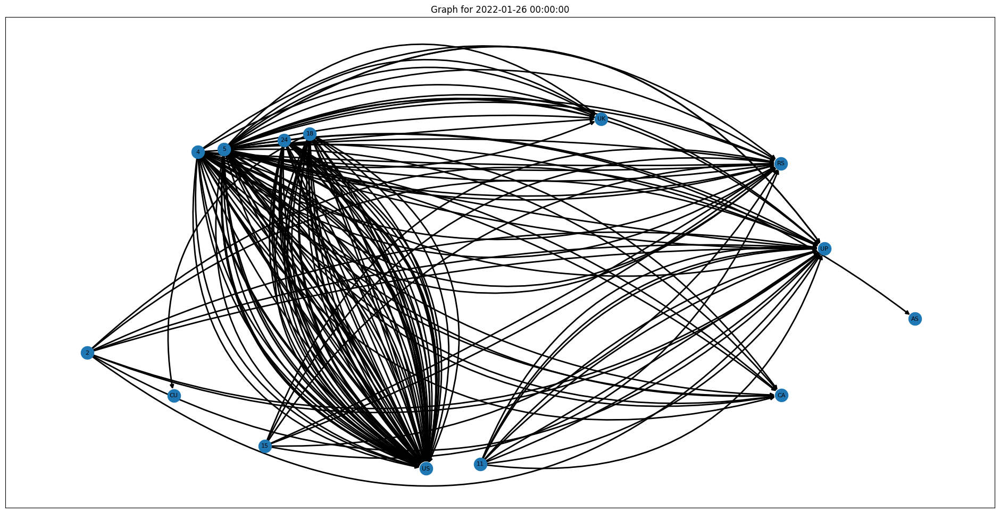

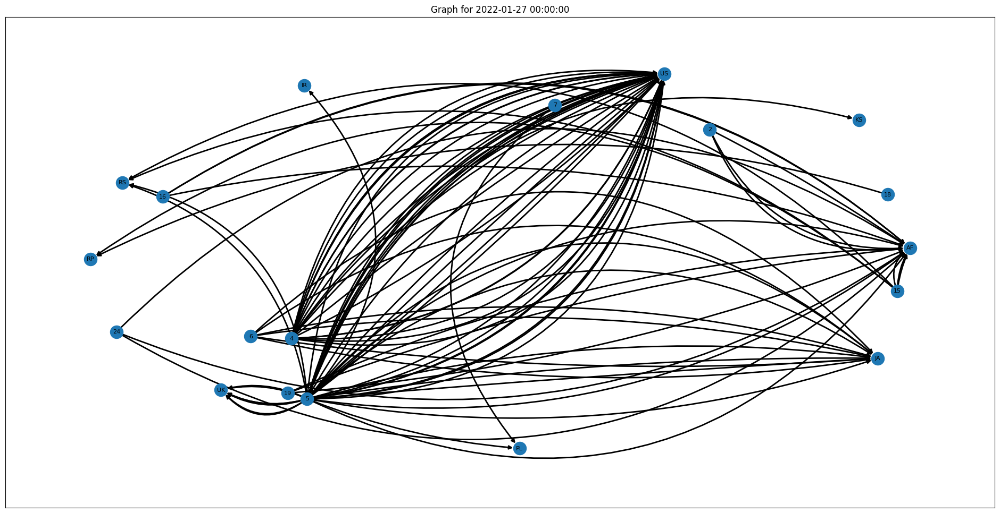

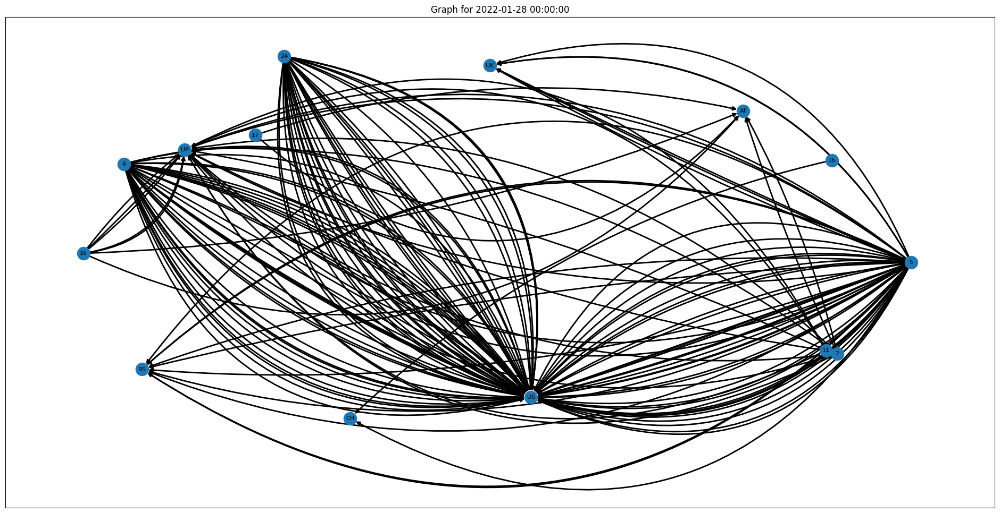

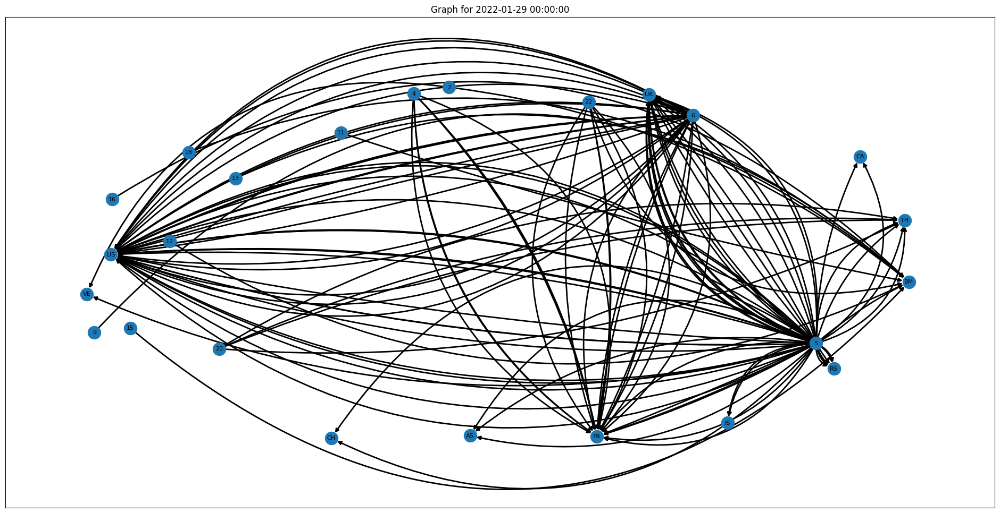

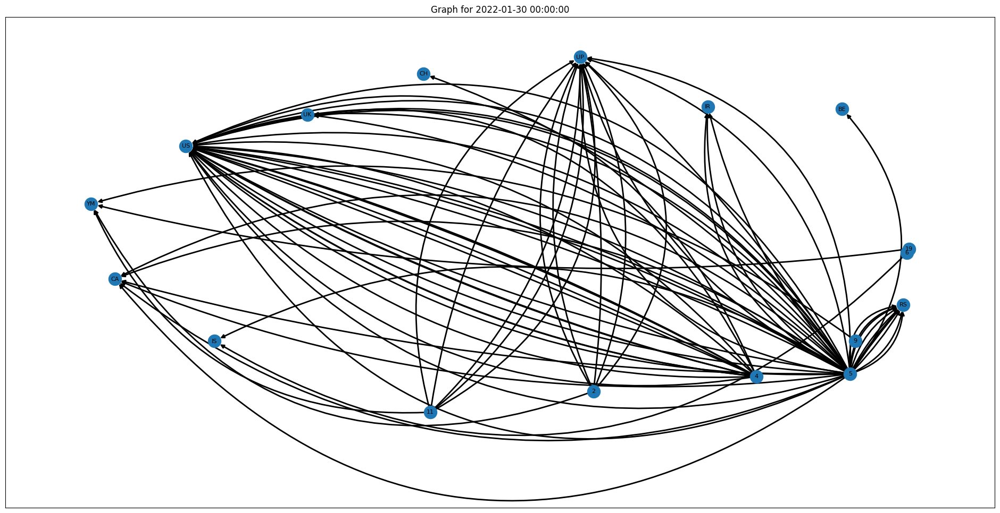

peak memory: 1630.80 MiB, increment: 101.01 MiB


In [63]:
%%memit
import networkx as nx
import random
    
graphs_by_date = {}

for date, group in gdf1.groupby('SQLDATE'):
    G = nx.MultiDiGraph()
    for _, row in group.iterrows():
    # Check if any of y0 to y24 has a value of 1
        for i in range(25):
            if row[f'y{i}'] == 1:
                # Get relevant information
                event = i
                action_geo = row['ActionGeo_CountryCode']
                weight = row['scaled_mood']
                #weight = row[f'y{i}']
                curvature = random.uniform(-1, 1)
                ec = row['EventCode']
                #color = float((i+1)/26)
                # Create a new edge with weight and scaled mood
                G.add_edge(event, action_geo, weight=weight, EventCode = ec, curvature = curvature)
    graphs_by_date[date] = G
        
for date, G in graphs_by_date.items():
#     node_to_remove = np.nan
#     # Remove the node and its edges
#     if !node_to_remove:
#         G.remove_node(node_to_remove)
    pos = nx.spring_layout(G)  # You can change the layout algorithm if needed
    labels = nx.get_edge_attributes(G, 'event_code')

    plt.figure(figsize=(24, 12))

    
    
    for (u, v, edge_data) in G.edges(data=True):
        curvature = edge_data["curvature"]*0.5
        connection_style = f'arc3,rad={curvature}'
        #color = edge_data['color']
        #print(color)
        nx.draw_networkx_edges(G, pos, edgelist=[(u, v)], width=2, connectionstyle=connection_style)

    nx.draw_networkx_nodes(G, pos)
    nx.draw_networkx_labels(G, pos, font_size=8)
    plt.title(f"Graph for {date}")
    plt.show()


In [64]:
end_time = time.time()
runtime = end_time - start_time
print(f"\n \n *** Graph visualization executed in {runtime:.4f} seconds *** \n \n")


 
 *** Graph visualization executed in 19.4914 seconds *** 
 



In [65]:
count = 0
for edge in G.edges(data=True):
    source, target, weight = edge
    count+= 1
    print(source, target, weight)
print(count)

5 RS {'weight': -11536.000297161101, 'EventCode': 163, 'curvature': -0.45453037602817936}
5 RS {'weight': -3540.4227269383027, 'EventCode': 120, 'curvature': -0.7586909895331362}
5 RS {'weight': -3515.850002826129, 'EventCode': 129, 'curvature': 0.12555109424150723}
5 RS {'weight': -1934.819772795612, 'EventCode': 12, 'curvature': -0.11060926164986462}
5 RS {'weight': -3050.1500774134547, 'EventCode': 172, 'curvature': 0.5457351002313668}
5 RS {'weight': -526.307428361027, 'EventCode': 13, 'curvature': 0.7090086751532445}
5 RS {'weight': -2452.3469871068774, 'EventCode': 129, 'curvature': -0.19910913190826895}
5 RS {'weight': -1371.7470486979635, 'EventCode': 10, 'curvature': -0.052743665237437565}
5 RS {'weight': -1170.4452480707478, 'EventCode': 12, 'curvature': -0.9956778236944084}
5 RS {'weight': -1792.9317626908803, 'EventCode': 110, 'curvature': -0.6860659794635195}
5 CA {'weight': -7554.588643787129, 'EventCode': 160, 'curvature': 0.5404076741162338}
5 CA {'weight': -5435.926346

##### Remove nan nodes from graph (Optional)

## Transfer Learning

In [66]:
!pip install torch --upgrade
!pip install torchvision
!pip install pytorch_tabnet

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchvision 0.16.1 requires torch==2.1.1, but you have torch 2.1.2 which is incompatible.

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip



  Obtaining dependency information for torch from https://files.pythonhosted.org/packages/e4/ae/2ad8820045b6631965750435f28583e80905b8273d57cf026163b51323ee/torch-2.1.2-cp311-cp311-win_amd64.whl.metadata
   ---------------------------------------- 0.0/192.3 MB ? eta -:--:--
   ---------------------------------------- 0.1/192.3 MB 1.9 MB/s eta 0:01:41
   ---------------------------------------- 0.2/192.3 MB 2.1 MB/s eta 0:01:32
   ---------------------------------------- 0.2/192.3 MB 2.1 MB/s eta 0:01:33
   ---------------------------------------- 0.3/192.3 MB 2.0 MB/s eta 0:01:38
   ---------------------------------------- 0.3/192.3 MB 1.7 MB/s eta 0:01:51
   ---------------------------------------- 0.4/192.3 MB 1.6 MB/s eta 0:01:58
   ---------------------------------------- 0.4/192.3 MB 1.5 MB/s eta 0:02:08
   ---------------------------------------- 0.4/192.3 MB 1.5 MB/s eta 0:02:09
   ---------------------------------------- 0.5/192.3 MB 1.4 MB/s eta 0:02:14
   -------------------


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [67]:
print(xdf1.head())
print(ydf1.head())

       IsRootEvent EventBaseCode EventRootCode  ActionGeo_Type   importance  \
317              1            10             1               0  2061.666667   
834              1           160            16               2  1262.333333   
1484             1           114            11               0  1159.666667   
35839            1            14             1               2  1117.000000   
15831            1            43             4               2  1115.333333   

       scaled_mood  A1GCC__AE  A1GCC__AF  A1GCC__AG  A1GCC__AL  A1GCC__AM  \
317   -5060.735897      False      False      False      False      False   
834   -4852.576083      False      False      False      False      False   
1484  -3814.631776      False      False      False      False      False   
35839 -3307.349424      False      False      False      False      False   
15831  1743.673384      False      False      False      False      False   

       A1GCC__AS  A1GCC__BE  A1GCC__BF  A1GCC__BM  A1GCC__BO  

### TabNet

In [68]:
start_time = time.time()

In [69]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from pytorch_tabnet.tab_model import TabNetRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score


@profile
def TabNetModel(xdf1,ydf1):
    X = xdf1
    Y = ydf1

    # Step 1: Split the data into training and testing sets
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

    # Step 2: Standardize the data
    scaler_X = StandardScaler()
    scaler_Y = StandardScaler()

    X_train_scaled = scaler_X.fit_transform(X_train)
    X_test_scaled = scaler_X.transform(X_test)

    Y_train_scaled = scaler_Y.fit_transform(Y_train)
    Y_test_scaled = scaler_Y.transform(Y_test)

    # Step 3: Create and train the TabNet model
    model = TabNetRegressor()
    model.fit(X_train_scaled, Y_train_scaled, eval_set=[(X_test_scaled, Y_test_scaled)], patience=10, max_epochs=100)

    # Step 4: Make predictions on the test set
    predictions_scaled = model.predict(X_test_scaled)

    # Step 5: Inverse transform the predictions to get them back to the original scale
    predictions = scaler_Y.inverse_transform(predictions_scaled)
    print(predictions)

    # Define a threshold for classification
    threshold = 0.5
    predicted_classes = (predictions > threshold).astype(int)

    mse = mean_squared_error(Y_test, predictions)
    mae = mean_absolute_error(Y_test, predictions)
    r2 = r2_score(Y_test, predictions)

    print("Mean Squared Error:", mse)
    print("Mean Absolute Error:", mae)
    print("R-squared:", r2)

    # Now 'predictions' contains the predicted values for Y columns based on X

In [70]:
%%memit
TabNetModel(xdf1,ydf1)

ERROR: Could not find file C:\Users\aadit\AppData\Local\Temp\ipykernel_18860\4098504192.py


c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\pytorch_tabnet\abstract_model.py:82: UserWarning: Device used : cpu
  warnings.warn(f"Device used : {self.device}")


epoch 0  | loss: 2.69671 | val_0_mse: 0.86624 |  0:00:00s
epoch 1  | loss: 2.16439 | val_0_mse: 0.85946 |  0:00:00s
epoch 2  | loss: 1.78712 | val_0_mse: 0.86343 |  0:00:01s
epoch 3  | loss: 1.59683 | val_0_mse: 0.86127 |  0:00:01s
epoch 4  | loss: 1.25789 | val_0_mse: 0.87624 |  0:00:02s
epoch 5  | loss: 1.08018 | val_0_mse: 0.89089 |  0:00:02s
epoch 6  | loss: 1.11228 | val_0_mse: 0.91839 |  0:00:02s
epoch 7  | loss: 1.05874 | val_0_mse: 0.92013 |  0:00:03s
epoch 8  | loss: 1.00865 | val_0_mse: 0.93133 |  0:00:03s
epoch 9  | loss: 0.97339 | val_0_mse: 0.93127 |  0:00:04s
epoch 10 | loss: 0.90855 | val_0_mse: 0.9141  |  0:00:04s
epoch 11 | loss: 0.90347 | val_0_mse: 0.91036 |  0:00:04s

Early stopping occurred at epoch 11 with best_epoch = 1 and best_val_0_mse = 0.85946


c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\pytorch_tabnet\callbacks.py:172: UserWarning: Best weights from best epoch are automatically used!
  warnings.warn(wrn_msg)


[[ 0.00138047  0.00097522  0.06169752 ...  0.03002055  0.02697829
   0.09160805]
 [ 0.00139804  0.00094093  0.06179794 ...  0.02971235  0.02532213
   0.09289058]
 [ 0.00141891  0.00090021  0.06191722 ...  0.02934627  0.02335501
   0.09441392]
 ...
 [ 0.00140355  0.00093018  0.06182943 ...  0.02961572  0.02480289
   0.09329268]
 [ 0.01042849  0.00431746  0.10600255 ...  0.07528856 -0.07395444
  -0.01996734]
 [-0.00079451 -0.00319547  0.04490662 ...  0.04533251 -0.2762809
   0.0413036 ]]
Mean Squared Error: 0.035716973303037164
Mean Absolute Error: 0.07821961322414198
R-squared: -0.10596109482488313
peak memory: 1890.15 MiB, increment: 269.23 MiB


In [71]:
print(np.min(predictions))
print(np.max(predictions))

0
1


In [72]:

end_time = time.time()
runtime = end_time - start_time
print(f"\n \n *** Tabnet executed in {runtime:.4f} seconds *** \n \n")


 
 *** Tabnet executed in 11.1674 seconds *** 
 



### XGBoost

In [73]:
start_time = time.time()

In [74]:
!pip install xgboost


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [75]:
print(xdf1.dtypes)
xgxdf1 = xdf1
columnsDrop = ['EventBaseCode', 'EventRootCode']
xgxdf1 = xgxdf1.drop(columns=columnsDrop)

IsRootEvent          int64
EventBaseCode       object
EventRootCode       object
ActionGeo_Type       int64
importance         float64
scaled_mood        float64
A1GCC__AE             bool
A1GCC__AF             bool
A1GCC__AG             bool
A1GCC__AL             bool
A1GCC__AM             bool
A1GCC__AS             bool
A1GCC__BE             bool
A1GCC__BF             bool
A1GCC__BM             bool
A1GCC__BO             bool
A1GCC__BR             bool
A1GCC__BU             bool
A1GCC__BX             bool
A1GCC__CA             bool
A1GCC__CB             bool
A1GCC__CF             bool
A1GCC__CH             bool
A1GCC__CM             bool
A1GCC__CO             bool
A1GCC__CU             bool
A1GCC__CY             bool
A1GCC__DA             bool
A1GCC__EC             bool
A1GCC__EG             bool
A1GCC__EI             bool
A1GCC__EN             bool
A1GCC__ET             bool
A1GCC__FI             bool
A1GCC__FR             bool
A1GCC__GA             bool
A1GCC__GM             bool
A

In [76]:
import pandas as pd
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report

@profile
def XGBoostModel(xgxdf1, ydf1):
    X = xgxdf1
    Y = ydf1

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

    # Initialize an XGBoost classifier
    model = XGBClassifier(objective='binary:logistic', random_state=42)

    # Iterate through each column in Y and train a separate model for each
    for col in Y.columns:
        # Train the model on the current column
        model.fit(X_train, y_train[col])

        # Make predictions on the test set
        predictions = model.predict(X_test)
        print(predictions)

        # Evaluate the model
        accuracy = accuracy_score(y_test[col], predictions)
        report = classification_report(y_test[col], predictions)

        print(f"Results for column '{col}':")
        print(f"Accuracy: {accuracy}")
        print("Classification Report:")
        print(report)
        print("-" * 50)

In [78]:
%%memit
XGBoostModel(xgxdf1, ydf1)
end_time = time.time()
runtime = end_time - start_time
print(f"\n \n *** XG Boost executed in {runtime:.4f} seconds *** \n \n")

ERROR: Could not find file C:\Users\aadit\AppData\Local\Temp\ipykernel_18860\2863675209.py
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 

c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average,

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average,

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average,

[0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 

c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\aadit\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average,

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 